# Phase II: Data Curation, Exploratory Analysis and Plotting

# Motivation
As the city of Boston continues to grow and expand, the MBTA (Massachusetts Bay Transportation Authority) will need to evolve to meet the increasing transportation demands of the population. Public transit is a critical factor in urban development, and plays a role in economic mobility, reducing traffic congestion, and promoting sustainable living. However, despite its importance, certain neighborhoods in Boston remain underserved, creating "transit deserts" where access to reliable public transportation is limited. Residents in these areas often face longer commutes, reduced mobility, and increased reliance on cars, which can hinder economic opportunities, especially for lower-income individuals who rely on public transit the most.

To ensure equitable access to transportation across all neighborhoods, it is critical to identify and address these transit gaps. By analyzing data from the MBTA and Census, we can gain valuable insights into public transit availability and reliability, helping urban planners and policymakers prioritize transit improvements where they are most needed.

So, there are 2 questions we want to answer:
- “How does time between trains differ among the MBTA stations, and what factors contribute most to these delays?” Understanding these patterns is crucial for improving reliability and managing demand at high-traffic stations. An average headway will be sued for context.
- “Which neighborhoods should be prioritized for new transit routes or stop improvements based on population density and current proximity to public transit?” This question aims to highlight underserved areas, helping to guide future transit expansions that support equitable access across Boston.


# Data Collection and Cleaning
## Pipeline Over View
- load in MBTA data for transit stops
- - Will be limited to Subway and Light Rail
- - Will include all stops in Metro Boston
- - mbta_stops_df

- load in MBTA data for headway betweeen trains(time between trains arriving at a station)
- - Will be a value for every mbta stop
- - loaded in through a url download
- - apend 'average_headway_seconds' mbta_stops_df

- load in Census Population Data
- - populations for all block groups in the 3 Counties of Suffolk, Middlesex, Norfolk
- - this data does not have GEOID but we can easily build it by appending the various IDs

- load in Census Block Group Geo Data
- - The previous Census data tells us populaiton for a block, not where a block is on a map
- - This will be loaded in through a download link
- - Will open the zipfile use  IO library zip functions
- - gives us a shapefile to use.
- - tie to census data on GEOID
- - gives us a geodataframe merged_gdf with population and geo data

- census Data Cleaning
- - We will iterate through the merged_gdf to calculate the clostest stop to each census block group, appending it the geodataframe
- - refrences the mbta_stops_df to get stop locations
- - distacne to stop is between stop location and the center of the census block group

- Create Formula
- - Create a formula to calculate a demand score for each census block group, given population density and distance to nearest stop.

- finished geo dataframe gdf which has all nessecary data

- Visualization
- - Create Folium Maps that Visualize our problem and underserved areas.
- - Create a box plot that shows Average Headway for stops. 

In [1]:
# Libraries
import requests
import pandas as pd
import numpy as np
import geopandas as gpd
import json
import zipfile
import os
import io
import matplotlib.pyplot as plt

/Users/jasonlam/Library/Python/3.9/lib/python/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(


ModuleNotFoundError: No module named 'geopandas'

## Get Stop Locations and Info
We will collect the following:
- MBTA Stops(No bus stops or Commuter Rail)
- Stop Locations
- stop name
- stop attributes(route color)

In [ ]:
# API key
api_key = 'Insert API Key' 

# URL to get routes information
url_routes = 'https://api-v3.mbta.com/routes'
url_stops = 'https://api-v3.mbta.com/stops'

headers = {
    'x-api-key': api_key
}

# get request for the routes dataframe
response_routes = requests.get(url_routes, headers=headers)

if response_routes.status_code == 200:
    routes_data = response_routes.json()['data']
    
    # Create routes dataframe
    routes_df = pd.DataFrame([{
        'route_id': route['id'],
        'short_name': route['attributes'].get('short_name', 'N/A'),
        'long_name': route['attributes'].get('long_name', 'N/A'),
        'description': route['attributes'].get('description', 'N/A'),
        'type': route['attributes'].get('type', 'N/A')
    } for route in routes_data])
    
    # Filter out bus routes (type 3) and the CR(type 2)
    non_bus_routes_df = routes_df[(routes_df['type'] != 3) & (routes_df['type'] != 2) & (routes_df['type'] != 4)]
    
    # Send GET request for stops only for non-bus routes
    stops_per_route = []
    for route in non_bus_routes_df.itertuples():
        route_id = route.route_id
        url_stops_per_route = f'https://api-v3.mbta.com/stops?filter[route]={route_id}'
        response_stops = requests.get(url_stops_per_route, headers=headers)
        
        if response_stops.status_code == 200:
            stops_data = response_stops.json()['data']
            for stop in stops_data:
                stops_per_route.append({
                    'stop_id': stop['id'],
                    'stop_name': stop['attributes'].get('name', 'N/A'),
                    'latitude': stop['attributes'].get('latitude', 'N/A'),
                    'longitude': stop['attributes'].get('longitude', 'N/A'),
                    'municipality': stop['attributes'].get('municipality', 'N/A'),
                    'route_id': route_id,  # Linking the stop to the route
                })
    # Create stops dataframe
    mbta_stops_df = pd.DataFrame(stops_per_route)
    
    # Merge stops_df w/ non_bus_routes_df to get the line name w/ each stop
    mbta_stops_df = mbta_stops_df.merge(non_bus_routes_df[['route_id', 'short_name', 'long_name']], on='route_id', how='left')

else:
    print(f"Error fetching data: {response_routes.status_code}")

In [ ]:
print(mbta_stops_df.shape)
mbta_stops_df.head()

(155, 8)


,stop_id,stop_name,latitude,longitude,municipality,route_id,short_name,long_name
0,place-alfcl,Alewife,42.395830,-71.141287,Cambridge,Red,,Red Line
1,place-davis,Davis,42.396740,-71.121815,Somerville,Red,,Red Line
2,place-portr,Porter,42.388400,-71.119149,Cambridge,Red,,Red Line
3,place-harsq,Harvard,42.373362,-71.118956,Cambridge,Red,,Red Line
4,place-cntsq,Central,42.365486,-71.103802,Cambridge,Red,,Red Line


### Add Headway for each stop

In [ ]:
zip_url = "https://www.arcgis.com/sharing/rest/content/items/ccb2941254944803bbd4e2df58e09906/data"
csv_path = "MBTA_Headways_2024.csv"

# Check if the CSV already exists locally
if not os.path.exists(csv_path):
    print("CSV not found. Downloading...")

    # Send GET request to download the zip file
    response = requests.get(zip_url)
    
    # If the request is successful, continue
    if response.status_code == 200:
        # Extract the CSV file from the zip archive
        with zipfile.ZipFile(io.BytesIO(response.content)) as z:
            # Find the CSV file within the zip archive
            for file in z.namelist():
                if file.endswith(".csv"):
                    with z.open(file) as f:
                        headways_df = pd.read_csv(f)
                        headways_df.to_csv(csv_path, index=False)
                        print("CSV downloaded, extracted, and saved locally.")
                        break
    else:
        print(f"Error: {response.status_code}")
else:
    print("CSV already exists.")

# Load the data into a DataFrame if downloaded successfully
headways_df = pd.read_csv(csv_path)
headways_df.head()

CSV already exists.


C:\Users\dar14\AppData\Local\Temp\ipykernel_6612\501467087.py:29: DtypeWarning: Columns (8) have mixed types. Specify dtype option on import or set low_memory=False.
  headways_df = pd.read_csv(csv_path)


,service_date,route_id,trunk_route_id,branch_route_id,trip_id,direction_id,direction,parent_station,stop_id,stop_name,stop_departure_datetime,stop_departure_sec,headway_trunk_seconds,headway_branch_seconds
0,2024-01-01,Green-B,Green,Green-B,60564050,1,East,place-babck,170136,Babcock Street,2024-01-01T05:41:57Z,20517,NaN,NaN
1,2024-01-01,Green-B,Green,Green-B,ADDED-1581739663,1,East,place-babck,170136,Babcock Street,2024-01-01T05:53:27Z,21207,690.0,690.0
2,2024-01-01,Green-B,Green,Green-B,ADDED-1581739665,1,East,place-babck,170136,Babcock Street,2024-01-01T06:03:21Z,21801,594.0,594.0
3,2024-01-01,Green-B,Green,Green-B,ADDED-1581739671,1,East,place-babck,170136,Babcock Street,2024-01-01T06:08:32Z,22112,311.0,311.0
4,2024-01-01,Green-B,Green,Green-B,60564070,1,East,place-babck,170136,Babcock Street,2024-01-01T06:24:06Z,23046,934.0,934.0


In [ ]:
# Ensure we have the correct columns in each DataFrame
# Fill missing headway values in 'headway_branch_seconds'
headways_df['headway_branch_seconds'].fillna(headways_df['headway_trunk_seconds'], inplace=True)

# Calculate average headway for each parent station
headways_avg = headways_df.groupby('parent_station').agg(
    average_headway_seconds=('headway_branch_seconds', 'mean')
).reset_index()

# Merge with mbta_Stops_df using stop_id in mbta_Stops_df and parent_station in headways_avg
mbta_stops_df = mbta_stops_df.merge(headways_avg, left_on='stop_id', right_on='parent_station', how='left')

# Display the result
mbta_stops_df.head()

,stop_id,stop_name,latitude,longitude,municipality,route_id,short_name,long_name,parent_station,average_headway_seconds
0,place-alfcl,Alewife,42.395830,-71.141287,Cambridge,Red,,Red Line,place-alfcl,769.250000
1,place-davis,Davis,42.396740,-71.121815,Somerville,Red,,Red Line,place-davis,1117.343297
2,place-portr,Porter,42.388400,-71.119149,Cambridge,Red,,Red Line,place-portr,1118.654242
3,place-harsq,Harvard,42.373362,-71.118956,Cambridge,Red,,Red Line,place-harsq,1115.132640
4,place-cntsq,Central,42.365486,-71.103802,Cambridge,Red,,Red Line,place-cntsq,1116.596980


## Census Data
Load in population data for census blocks
- Load for all 3 counties
- Reducing scope to countries in Greater Boston could maybe be doen but seems like alot of work

In [ ]:
api_key = 'Insert API Key' 

# Updated URL to include multiple counties for Greater Boston area (Middlesex 17, Suffolk 21, and Norfolk 25 counties)
url = f"https://api.census.gov/data/2020/dec/pl?get=P1_001N,NAME&for=block group:*&in=state:25 county:017,021,025&key={api_key}"

response = requests.get(url)

if response.status_code == 200:
    # Convert the API response to a DataFrame
    data = response.json()
    columns = data[0]  # Column names
    population_data = pd.DataFrame(data[1:], columns=columns)

    # Rename the columns for clarity
    population_data.rename(columns={
        'P1_001N': 'population',
        'NAME': 'block_group_name',
        'block group': 'block_group_id'
    }, inplace=True)

    # Convert population to numeric
    population_data['population'] = pd.to_numeric(population_data['population'])

    # Construct the GEOID by combining state, county, tract, and block_group_id so we can tie it to census blocks
    population_data['GEOID'] = (
        population_data['state'] +
        population_data['county'] +
        population_data['tract'] +
        population_data['block_group_id']
    )
else:
    print(f"Error: {response.status_code}")

In [ ]:
population_data.head(300)

,population,block_group_name,state,county,tract,block_group_id,GEOID
0,926,"Block Group 5, Census Tract 3116, Middlesex Co...",25,017,311600,5,250173116005
1,1216,"Block Group 3, Census Tract 3117, Middlesex Co...",25,017,311700,3,250173117003
2,1779,"Block Group 2, Census Tract 3118, Middlesex Co...",25,017,311800,2,250173118002
3,1451,"Block Group 1, Census Tract 3120, Middlesex Co...",25,017,312000,1,250173120001
4,1224,"Block Group 2, Census Tract 3121, Middlesex Co...",25,017,312100,2,250173121002
...,...,...,...,...,...,...,...
295,691,"Block Group 2, Census Tract 3826.01, Middlesex...",25,017,382601,2,250173826012
296,925,"Block Group 1, Census Tract 3826.02, Middlesex...",25,017,382602,1,250173826021
297,1097,"Block Group 4, Census Tract 3826.02, Middlesex...",25,017,382602,4,250173826024
298,2268,"Block Group 1, Census Tract 3831.02, Middlesex...",25,017,383102,1,250173831021


## Geo Data
We have the populations for census block groups, but not where those block groups actually are on a map. We will load this in through a downlaoded file, so not through an API

In [ ]:
# URL for the 2020 Census Block Groups Shapefile (Massachusetts)
shapefile_url = 'https://s3.us-east-1.amazonaws.com/download.massgis.digital.mass.gov/shapefiles/census2020/CENSUS2020_BLK_BG_TRCT.zip'

# Directory and file paths
download_dir = "census_block_groups"
shapefile_path = os.path.join(download_dir, "CENSUS2020BLOCKGROUPS_POLY.shp")

# Check if the shapefile already exists locally
if not os.path.exists(shapefile_path):
    print("Shapefile not found. Downloading...")

    # Send GET request to download the shapefile
    response = requests.get(shapefile_url)

    # If the request is successful, continue
    if response.status_code == 200:
        # Use BytesIO to handle the zip file in memory
        with zipfile.ZipFile(io.BytesIO(response.content)) as z:
            # Extract all files from the zip to the download directory
            z.extractall(download_dir)
        print("Shapefile downloaded and extracted.")
    else:
        print(f"Error: {response.status_code}")
else:
    print("Shapefile already exists.")

# Load the shapefile into a GeoDataFrame
block_group_gdf = gpd.read_file(shapefile_path)

Shapefile already exists.


In [ ]:
block_group_gdf.shape #this is all census block groups in Massachustes

(5109, 20)

In [ ]:
# Rename the GEOID20 column to GEOID so we can tie it to census data
block_group_gdf.rename(columns={'GEOID20': 'GEOID'}, inplace=True)

In [ ]:
# covnert both GEOID columns are strings
population_data['GEOID'] = population_data['GEOID'].astype(str)
block_group_gdf['GEOID'] = block_group_gdf['GEOID'].astype(str)

In [ ]:
# Perform the left merge with the population data and keep the merge indicator
merged_gdf = block_group_gdf.merge(population_data, on='GEOID', how='left', indicator=True)

# Filter out rows where the merge was unsuccessful (census block exists but not in the 3 counties we are looking at)
merged_gdf = merged_gdf[merged_gdf['_merge'] == 'both']
# Drop the '_merge' column
merged_gdf = merged_gdf.drop(columns=['_merge'])

# Display the resulting GeoDataFrame
print(merged_gdf.head())


   STATEFP20 COUNTYFP20 TRACTCE20 BLKGRPCE20         GEOID     NAMELSAD20  \
24        25        021    417702          2  250214177022  Block Group 2   
25        25        017    334100          3  250173341003  Block Group 3   
26        25        017    353900          2  250173539002  Block Group 2   
27        25        017    354100          2  250173541002  Block Group 2   
28        25        017    341901          1  250173419011  Block Group 1   

   MTFCC20   ALAND20  AWATER20   INTPTLAT20  ... BLK20_CNT     SHAPE_AREA  \
24   G5030  896706.0  193194.0  +42.2583235  ...        11  905488.383690   
25   G5030  968421.0       0.0  +42.5170961  ...        22  968380.905042   
26   G5030  112138.0   52563.0  +42.3662691  ...        18  164690.864669   
27   G5030  363851.0   47168.0  +42.3754773  ...        27  410994.334336   
28   G5030  473237.0    1681.0  +42.4289336  ...        15  474889.683799   

      SHAPE_LEN                                           geometry  \
24  

In [ ]:
# Project it to a CRS that uses meters (EPSG:3857) to calculate area in square meters
merged_gdf = merged_gdf.to_crs(epsg=3857)

# Calculate area in square miles
merged_gdf['area_sq_miles'] = merged_gdf['geometry'].area / (1609.34 ** 2)  # Square meters to square miles formual

# Calculate density
merged_gdf['population_density'] = merged_gdf['population'] / merged_gdf['area_sq_miles']

# Handle cases 0 
merged_gdf['population_density'].replace([float('inf'), -float('inf')], 0, inplace=True)

print(merged_gdf[['GEOID', 'population', 'area_sq_miles', 'population_density']].head())


           GEOID  population  area_sq_miles  population_density
24  250214177022      1054.0       0.638695         1650.239978
25  250173341003      1777.0       0.688655         2580.393407
26  250173539002      1661.0       0.116566        14249.453682
27  250173541002      1744.0       0.290978         5993.576312
28  250173419011       793.0       0.336774         2354.692705


In [ ]:
# Check the min and max of population density so we can better bin it when mapping
print(merged_gdf['population_density'].min(), merged_gdf['population_density'].max())

0.0 117307.83364764288


In [ ]:
merged_gdf.head()

,STATEFP20,COUNTYFP20,TRACTCE20,BLKGRPCE20,GEOID,NAMELSAD20,MTFCC20,ALAND20,AWATER20,INTPTLAT20,...,SHAPE_LEN,geometry,population,block_group_name,state,county,tract,block_group_id,area_sq_miles,population_density
24,25,021,417702,2,250214177022,Block Group 2,G5030,896706.0,193194.0,+42.2583235,...,6188.165741,"POLYGON ((-7901590.372 5199805.605, -7901606.9...",1054.0,"Block Group 2, Census Tract 4177.02, Norfolk C...",25,021,417702,2,0.638695,1650.239978
25,25,017,334100,3,250173341003,Block Group 3,G5030,968421.0,0.0,+42.5170961,...,5298.770491,"POLYGON ((-7917020.033 5238883.639, -7917014.3...",1777.0,"Block Group 3, Census Tract 3341, Middlesex Co...",25,017,334100,3,0.688655,2580.393407
26,25,017,353900,2,250173539002,Block Group 2,G5030,112138.0,52563.0,+42.3662691,...,2512.792894,"POLYGON ((-7916744.628 5216443.301, -7916726.8...",1661.0,"Block Group 2, Census Tract 3539, Middlesex Co...",25,017,353900,2,0.116566,14249.453682
27,25,017,354100,2,250173541002,Block Group 2,G5030,363851.0,47168.0,+42.3754773,...,3805.183149,"POLYGON ((-7917877.415 5218133.997, -7917853.1...",1744.0,"Block Group 2, Census Tract 3541, Middlesex Co...",25,017,354100,2,0.290978,5993.576312
28,25,017,341901,1,250173419011,Block Group 1,G5030,473237.0,1681.0,+42.4289336,...,4165.376423,"POLYGON ((-7908240.598 5224622.774, -7908322.7...",793.0,"Block Group 1, Census Tract 3419.01, Middlesex...",25,017,341901,1,0.336774,2354.692705


In [ ]:
gdf = merged_gdf[merged_gdf['block_group_id'].notna()]

In [ ]:
gdf.head()

,STATEFP20,COUNTYFP20,TRACTCE20,BLKGRPCE20,GEOID,NAMELSAD20,MTFCC20,ALAND20,AWATER20,INTPTLAT20,...,SHAPE_LEN,geometry,population,block_group_name,state,county,tract,block_group_id,area_sq_miles,population_density
24,25,021,417702,2,250214177022,Block Group 2,G5030,896706.0,193194.0,+42.2583235,...,6188.165741,"POLYGON ((-7901590.372 5199805.605, -7901606.9...",1054.0,"Block Group 2, Census Tract 4177.02, Norfolk C...",25,021,417702,2,0.638695,1650.239978
25,25,017,334100,3,250173341003,Block Group 3,G5030,968421.0,0.0,+42.5170961,...,5298.770491,"POLYGON ((-7917020.033 5238883.639, -7917014.3...",1777.0,"Block Group 3, Census Tract 3341, Middlesex Co...",25,017,334100,3,0.688655,2580.393407
26,25,017,353900,2,250173539002,Block Group 2,G5030,112138.0,52563.0,+42.3662691,...,2512.792894,"POLYGON ((-7916744.628 5216443.301, -7916726.8...",1661.0,"Block Group 2, Census Tract 3539, Middlesex Co...",25,017,353900,2,0.116566,14249.453682
27,25,017,354100,2,250173541002,Block Group 2,G5030,363851.0,47168.0,+42.3754773,...,3805.183149,"POLYGON ((-7917877.415 5218133.997, -7917853.1...",1744.0,"Block Group 2, Census Tract 3541, Middlesex Co...",25,017,354100,2,0.290978,5993.576312
28,25,017,341901,1,250173419011,Block Group 1,G5030,473237.0,1681.0,+42.4289336,...,4165.376423,"POLYGON ((-7908240.598 5224622.774, -7908322.7...",793.0,"Block Group 1, Census Tract 3419.01, Middlesex...",25,017,341901,1,0.336774,2354.692705


## Census Data Extraction Continued:
Adding: 'closest_stop', 'stop location', 'distance_to_stop'

In [ ]:
import geopandas as gpd
from shapely.geometry import Point
from geopy.distance import geodesic
from shapely.ops import nearest_points

In [ ]:
# Pre-calculate centroids for all blocks in the projected CRS (UTM Zone 18N, EPSG:32618)
gdf_projected = gdf.to_crs(epsg=32618)
gdf_projected['centroid'] = gdf_projected.geometry.centroid

# Now reproject the centroids back to the geographic CRS (WGS84, EPSG:4326)
gdf_projected = gdf_projected.set_geometry('centroid')
gdf_projected = gdf_projected.to_crs(epsg=4326)

In [ ]:
print(gdf_projected['centroid'].head())  # Print some centroid coordinates

24    POINT (-70.98916 42.25811)
25     POINT (-71.12353 42.5171)
26    POINT (-71.11692 42.36721)
27    POINT (-71.12694 42.37617)
28    POINT (-71.03592 42.42889)
Name: centroid, dtype: geometry


In [ ]:
def find_closest_stop(block_centroid, stops_gdf):
    """
    Parameters:
    block_centroid: A point object to the geographical center of a census block.
    stopd_gdf: A geographical dataframe containing all the mbta transit stops and their locations.
    
    Returns:
    3 columns: Name of the closest stop, tuple of the stops (y, x) location, the distance from the block centroid to the stop. 

    Raises:
    TypeError: If block_centroid entered is not an appropriate Point object.
    """

    if not isinstance(block_centroid, Point):
        raise TypeError("block_centroid must be a shapely.geometry.Point object") #fixed using to_crs
    
    # Use nearest_points to find the closest stop
    stop = nearest_points(block_centroid, stops_gdf.geometry.union_all())[1]

    # Find the corresponding stop in stops_gdf
    closest_stop = stops_gdf[stops_gdf.geometry == stop].iloc[0]
    
    # block and stop locations are  (latitude, longitude)
    block_location = (block_centroid.y, block_centroid.x)  
    stop_location = (stop.y, stop.x)  

    # Debugging: Print the block and stop locations
    # print(f"Block location: {block_location}, Stop location: {stop_location}")

    distance = geodesic(block_location, stop_location).meters
    
    return closest_stop['stop_name'], (stop.y, stop.x), distance

In [ ]:
# Create MBTA stops GeoDataFrame from lat/lon columns
mbta_stops_df.loc[:, 'geometry'] = gpd.points_from_xy(mbta_stops_df['longitude'], mbta_stops_df['latitude'])
mbta_stops_gdf = gpd.GeoDataFrame(mbta_stops_df, geometry='geometry')

In [ ]:
# Apply the function to each census block using pre-calculated centroids
gdf['closest_stop'], gdf['stop_location'], gdf['distance_to_stop'] = zip(
    *gdf_projected['centroid'].apply(find_closest_stop, stops_gdf=mbta_stops_gdf)
)

In [ ]:
print(gdf.shape)
gdf.head()

(2361, 31)


,STATEFP20,COUNTYFP20,TRACTCE20,BLKGRPCE20,GEOID,NAMELSAD20,MTFCC20,ALAND20,AWATER20,INTPTLAT20,...,block_group_name,state,county,tract,block_group_id,area_sq_miles,population_density,closest_stop,stop_location,distance_to_stop
24,25,021,417702,2,250214177022,Block Group 2,G5030,896706.0,193194.0,+42.2583235,...,"Block Group 2, Census Tract 4177.02, Norfolk C...",25,021,417702,2,0.638695,1650.239978,Quincy Center,"(42.251809, -71.005409)",1512.305774
25,25,017,334100,3,250173341003,Block Group 3,G5030,968421.0,0.0,+42.5170961,...,"Block Group 3, Census Tract 3341, Middlesex Co...",25,017,334100,3,0.688655,2580.393407,Oak Grove,"(42.43668, -71.071097)",9918.876638
26,25,017,353900,2,250173539002,Block Group 2,G5030,112138.0,52563.0,+42.3662691,...,"Block Group 2, Census Tract 3539, Middlesex Co...",25,017,353900,2,0.116566,14249.453682,Harvard,"(42.373362, -71.118956)",704.202466
27,25,017,354100,2,250173541002,Block Group 2,G5030,363851.0,47168.0,+42.3754773,...,"Block Group 2, Census Tract 3541, Middlesex Co...",25,017,354100,2,0.290978,5993.576312,Harvard,"(42.373362, -71.118956)",727.678962
28,25,017,341901,1,250173419011,Block Group 1,G5030,473237.0,1681.0,+42.4289336,...,"Block Group 1, Census Tract 3419.01, Middlesex...",25,017,341901,1,0.336774,2354.692705,Oak Grove,"(42.43668, -71.071097)",3021.480144


### Create Formula
This formula aims to measure demand for MBTA access for a given census block group

- We use a high cutoff of 10km. this is beyond the scope of our project and falls under Commuter Rail service
- We use a low cutoff of 800m, as this is considered the distacne an average persson is willing to walk to a rapid transit stop
- Known as the Half-Mile Circle (800m) standard
- https://planitmetro.com/2014/07/08/whats-the-ideal-size-for-a-transit-walkshed/

In [ ]:
high_cutoff_distance = 10000  # 10 km, beyond which outside fo our scope
low_cutoff_distance = 800     # Following the 'half-mile/800m rule'

# Function to calculate demand score with 0 below low cutoff and normal formula above cutoff, then 0 if very far away
def calculate_demand_score(pop_density, distance):
    if distance > high_cutoff_distance:
        return 0  # No demand for very remote areas
    elif distance < low_cutoff_distance:
        return 0  # No demand for already well-served areas
    else:
        # Demand decreases quadratically with lower population density and increases with distance
        return (pop_density ** 2) * (distance / low_cutoff_distance)

# Apply the function to each row
gdf['demand_score'] = gdf.apply(
    lambda row: calculate_demand_score(row['population_density'], row['distance_to_stop']), axis=1
)

# Ensure demand_score is finite (no inf and NaN)
gdf['demand_score'] = gdf['demand_score'].replace([np.inf, -np.inf], np.nan)  # Replace inf with NaN
gdf['demand_score'] = gdf['demand_score'].fillna(0)  # Fill NaN with 0 

# Scale the demand score to increase visibility (current is with the thousandths)
scaling_factor = .0000001
gdf['demand_score'] = gdf['demand_score'] * scaling_factor

In [ ]:
print(gdf.head())

   STATEFP20 COUNTYFP20 TRACTCE20 BLKGRPCE20         GEOID     NAMELSAD20  \
24        25        021    417702          2  250214177022  Block Group 2   
25        25        017    334100          3  250173341003  Block Group 3   
26        25        017    353900          2  250173539002  Block Group 2   
27        25        017    354100          2  250173541002  Block Group 2   
28        25        017    341901          1  250173419011  Block Group 1   

   MTFCC20   ALAND20  AWATER20   INTPTLAT20  ... state  county   tract  \
24   G5030  896706.0  193194.0  +42.2583235  ...    25     021  417702   
25   G5030  968421.0       0.0  +42.5170961  ...    25     017  334100   
26   G5030  112138.0   52563.0  +42.3662691  ...    25     017  353900   
27   G5030  363851.0   47168.0  +42.3754773  ...    25     017  354100   
28   G5030  473237.0    1681.0  +42.4289336  ...    25     017  341901   

   block_group_id  area_sq_miles  population_density   closest_stop  \
24              2    

# Visualization

In [ ]:
# importing libraries
import folium
from folium import Choropleth
from folium.plugins import Geocoder

Visualization 1 : Folium Mapping

In [ ]:
print(gdf['demand_score'].min(), gdf['demand_score'].max())

0.0 308.8560125944167


In [ ]:
# Define custom bins, change as needed
threshold_scale = [0, 12.5, 25, 50, 75, 150, 310] # Can adjust w/o full reload, just run all below

In [ ]:
# Define custom bins for demand scores
threshold_scale = [0, 12.5, 25, 50, 75, 150, 310]  # Adjustable bins

# Project GeoDataFrame back to WGS 84 (EPSG:4326) for proper mapping
gdf = gdf.to_crs(epsg=4326)

# Convert GeoDataFrame to GeoJSON format
geojson_data = gdf.to_json()

# Create a Folium map centered on Greater Boston
m1 = folium.Map(location=[42.3601, -71.0589], zoom_start=10)

# Add choropleth for demand scores
choropleth = folium.Choropleth(
    geo_data=geojson_data,
    name='choropleth',
    data=gdf,
    columns=['GEOID', 'demand_score'],
    key_on='feature.properties.GEOID',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    threshold_scale=threshold_scale,
    legend_name='Demand Score',
    reset=True
).add_to(m1)

# Add tooltips for each block
tooltip_fields = ['GEOID', 'demand_score', 'population_density', 'distance_to_stop']
tooltip_aliases = [
    "Block GEOID:",
    "Demand Score:",
    "Population Density:",
    "Distance to Stop (meters):"
]

# Add GeoJsonTooltip for tooltips
folium.features.GeoJson(
    geojson_data,
    style_function=lambda x: {
        'fillColor': '#transparent',
        'color': 'transparent',
        'fillOpacity': 0.0,
        'weight': 0
    },
    tooltip=folium.features.GeoJsonTooltip(
        fields=tooltip_fields,
        aliases=tooltip_aliases,
        localize=True
    )
).add_to(m1)

# Add train stop markers
for _, row in mbta_stops_df.iterrows():
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=f"{row['stop_name']} ({row['municipality']}) - {row['route_id']} Line",
        icon=folium.Icon(color='blue', icon='train', prefix='fa')
    ).add_to(m1)

# Add a geocoder search feature for any location
geocoder = Geocoder(add_marker=True)
m1.add_child(geocoder)

# Add a layer control to toggle visibility
folium.LayerControl().add_to(m1)

# Save the map to an HTML file
m1.save("demand_map_with_tooltips.html")


In [ ]:
m1

folium map 2

In [ ]:
# Check the min and max population density values
print(gdf['population_density'].min(), gdf['population_density'].max())

0.0 117307.83364764288


In [ ]:
# Create a folium map centered on the Greater Boston area
m2 = folium.Map(location=[42.3601, -71.0589], zoom_start=10)

# Define custom thresholds for population density
threshold_scale = [0, 500, 1000, 2000, 5000, 10000, 15000, 20000, 120000]  # Adjustable bins

# Add choropleth for population_density
folium.Choropleth(
    geo_data=geojson_data,
    name='choropleth',
    data=gdf,
    columns=['GEOID', 'population_density'],  # Use population density instead of demand score
    key_on='feature.properties.GEOID',
    fill_color='YlGnBu',  # Different color scale for population density
    fill_opacity=0.7,
    line_opacity=0.2,
    threshold_scale=threshold_scale,
    legend_name='Population Density (per sq mile)',
    reset=True
).add_to(m2)

# Add train stop markers to the map
for idx, row in mbta_stops_df.iterrows():
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=f"{row['stop_name']} ({row['municipality']}) - {row['route_id']} Line",
        icon=folium.Icon(color='blue', icon='train', prefix='fa')
    ).add_to(m2)

# Add a layer control to toggle the layers
folium.LayerControl().add_to(m2)

# Save the map to an HTML file
m2.save('population_density_map.html')

In [ ]:
m2

Visualization 2 : Headway By Station

In [ ]:
print(mbta_stops_df['average_headway_seconds'].describe())
print(mbta_stops_df['average_headway_seconds'].isna().sum())

count      143.000000
mean       988.409201
std       3592.773114
min        476.331781
25%        594.705962
50%        614.277073
75%        637.236229
max      43565.000000
Name: average_headway_seconds, dtype: float64
12


In [ ]:
mbta_stops_df = mbta_stops_df[mbta_stops_df['average_headway_seconds'] < 2000]

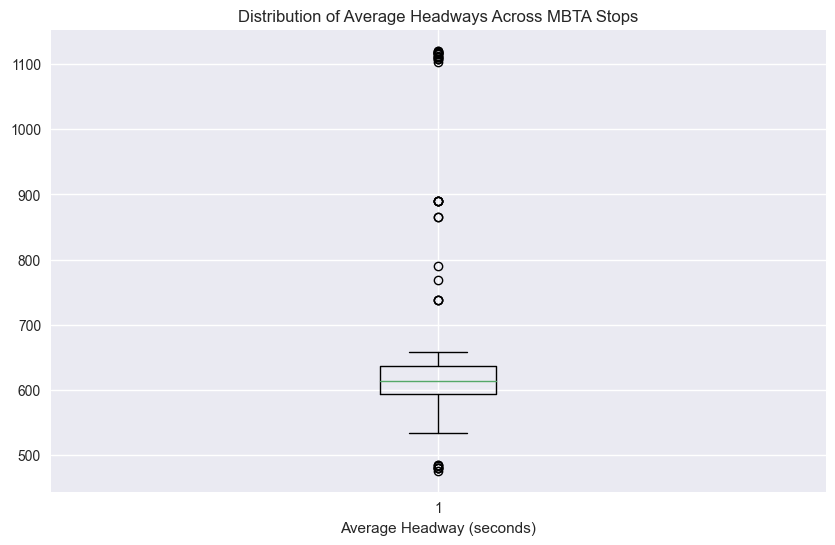

In [ ]:
# Plot with filtered data
plt.figure(figsize=(10, 6))
plt.boxplot(mbta_stops_df['average_headway_seconds'], vert=True)
plt.xlabel('Average Headway (seconds)')
plt.title('Distribution of Average Headways Across MBTA Stops')
plt.show()

# Machine Learning

### Feature Engineering

Before we do any ML we gotta deal with some aspects of our data
1. The cutoffs would make a simple approach not work. We will filter them out as we don't know any other approach.
2. We will need to keep in mind that linearity will be ahrd to apply to our formula which is quadratic.

In [ ]:
from sklearn.preprocessing import StandardScaler

In [ ]:
# Filter data
filtered_df = gdf[
    (gdf['distance_to_stop'] >= low_cutoff_distance) &
    (gdf['distance_to_stop'] <= high_cutoff_distance)
].copy()

In [ ]:
# Extract features and target
X = filtered_df[['population_density', 'distance_to_stop']].values
y = filtered_df['demand_score'].values

In [ ]:
# Scale the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

### Linear Regression (WIP)

In [ ]:
def linear_regression(X, y):
    """
    Does linear regression w/ NumPy.

    Params:
    X (ndarray): Feature matrix.
    y (ndarray): Target vector.

    Returns:
    coef (ndarray): Coefficients.
    intercept (float): Intercept value.
    """

    # Add column of ones
    X = np.hstack([np.ones((X.shape[0], 1)), X])

    # We will use the normal equation
    # theta = (X.T * X)^(-1) * X.T * y
    theta = np.linalg.inv(X.T @ X) @ X.T @ y

    intercept = theta[0]
    coef = theta[1:]

    return coef, intercept

In [ ]:
# Perform linear regression
coefficients, intercept = linear_regression(X_scaled, y)

In [ ]:
feature_names = ['population_density', 'distance_to_stop']
print("Model Coefficients:")
for name, coef in zip(feature_names, coefficients):
    print(f"{name}: {coef:.6f}")
print(f"Intercept: {intercept:.6f}")

Model Coefficients:
population_density: 27.041618
distance_to_stop: 7.237031
Intercept: 16.702854


In [ ]:
all_coefficients = np.append(intercept, coefficients)
X_for_pred = np.hstack([np.ones((X_scaled.shape[0], 1)), X_scaled])
predictions = X_for_pred.dot(all_coefficients)  

In [ ]:
# Convert to 1-10 scale
scores = 1 + 9 * (predictions - predictions.min()) / (predictions.max() - predictions.min())
filtered_df['transit_need_score'] = np.round(scores)

In [ ]:
# Example predictions
print("\nSample Results:")
print(filtered_df[['population_density', 'distance_to_stop', 
                  'demand_score', 'transit_need_score']].head())

y_mean = np.mean(y)
r_squared = 1 - np.sum((y - predictions)**2) / np.sum((y - y_mean)**2)
print(f"\nR-squared: {r_squared:.4f}")


Sample Results:
    population_density  distance_to_stop  demand_score  transit_need_score
24         1650.239978       1512.305774      0.514806                 2.0
25         2580.393407       9918.876638      8.255518                 3.0
28         2354.692705       3021.480144      2.094104                 2.0
29         1681.625863       3431.991161      1.213151                 2.0
56         2915.551658       2030.441111      2.157456                 2.0

R-squared: 0.7866


In [ ]:
mse = np.mean((predictions - y)**2)
rmse = np.sqrt(mse)


mae = np.mean(np.abs(predictions - y))

print(f"RMSE: {rmse:.4f}")
print(f"MAE: {mae:.4f}")

RMSE: 12.7043
MAE: 7.4909


C:\Users\dar14\AppData\Local\Temp\ipykernel_6612\3811959876.py:4: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn')
c:\Users\dar14\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


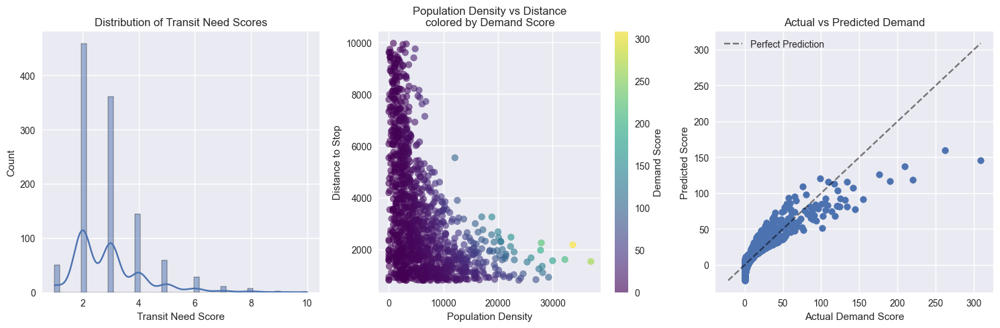


Linear Regression Summary:
R-squared: 0.7866


In [ ]:
import seaborn as sns

# Set style
plt.style.use('seaborn')
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))

# 1. Distribution of transit need scores
sns.histplot(data=filtered_df, x='transit_need_score', ax=ax1, kde=True)
ax1.set_title('Distribution of Transit Need Scores')
ax1.set_xlabel('Transit Need Score')
ax1.set_ylabel('Count')

# 2. Scatter plot: Population Density vs Distance with demand score as color
scatter = ax2.scatter(filtered_df['population_density'], 
                     filtered_df['distance_to_stop'],
                     c=filtered_df['demand_score'],
                     cmap='viridis',
                     alpha=0.6)
ax2.set_title('Population Density vs Distance\ncolored by Demand Score')
ax2.set_xlabel('Population Density')
ax2.set_ylabel('Distance to Stop')
plt.colorbar(scatter, ax=ax2, label='Demand Score')

# 3. Actual vs Predicted Demand Scores
ax3.scatter(filtered_df['demand_score'], predictions)
ax3.set_title('Actual vs Predicted Demand')
ax3.set_xlabel('Actual Demand Score')
ax3.set_ylabel('Predicted Score')
# Add 45-degree line for reference
lims = [
    min(min(filtered_df['demand_score']), min(predictions)),
    max(max(filtered_df['demand_score']), max(predictions))
]
ax3.plot(lims, lims, 'k--', alpha=0.5, label='Perfect Prediction')
ax3.legend()

# Adjust layout
plt.tight_layout()
plt.show()

# Print model summary
print("\nLinear Regression Summary:")
print(f"R-squared: {r_squared:.4f}")

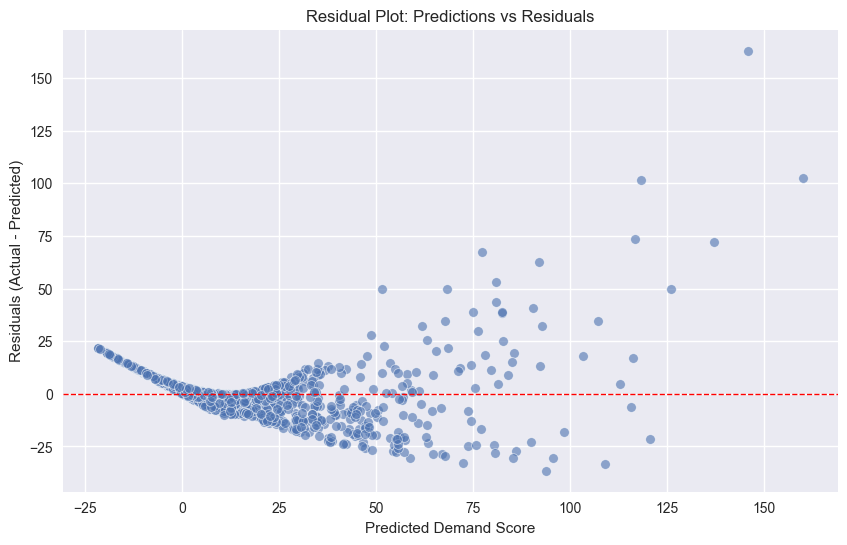

In [ ]:
# Calculate residuals
residuals = y - predictions

# Create a residual plot
plt.figure(figsize=(10, 6))
sns.scatterplot(x=predictions, y=residuals, alpha=0.6)
plt.axhline(0, color='red', linestyle='--', linewidth=1)
plt.title("Residual Plot: Predictions vs Residuals")
plt.xlabel("Predicted Demand Score")
plt.ylabel("Residuals (Actual - Predicted)")
plt.grid(True)
plt.show()

### Analysis

Our linear regression model tries to predict demand scores using population density and distance to stops, the same features we used to calculate these scores in the first place. With an R² of 0.7866, the model does a pretty good job, explaining about 79% of the variation in demand scores. However, the prediction errors (RMSE of 12.70 and MAE of 7.49) show that the model isn't perfect, especially when predicting higher demand scores. This makes sense because our original demand score calculation uses squared values and cutoff points, while this linear model can only approximate those relationships.

Looking at the graphs tells us more about the story. Most areas have low transit need scores (2-4), with very few scoring above 6. This will allow us to focus in on those areas later. Also, given how many far away blocks we have, it makes sense that so many are low demand, Just look at the Folium maps. 

When we look at how population density and distance relate to each other, we see again the outliers we should focus on. Around 20k - 30k population density with 1500 - 2300 km distance, it's an especially poorly served area.

The final graph shows how well our predictions match the actual demand scores. While the model does well for low demand scores, it starts to underpredict when demand gets higher. This again is due to the fact that squared valeus are used in the demand score formula.


Polynomial Regression Results:
Mean Squared Error: 31.7956
R-squared: 0.9580


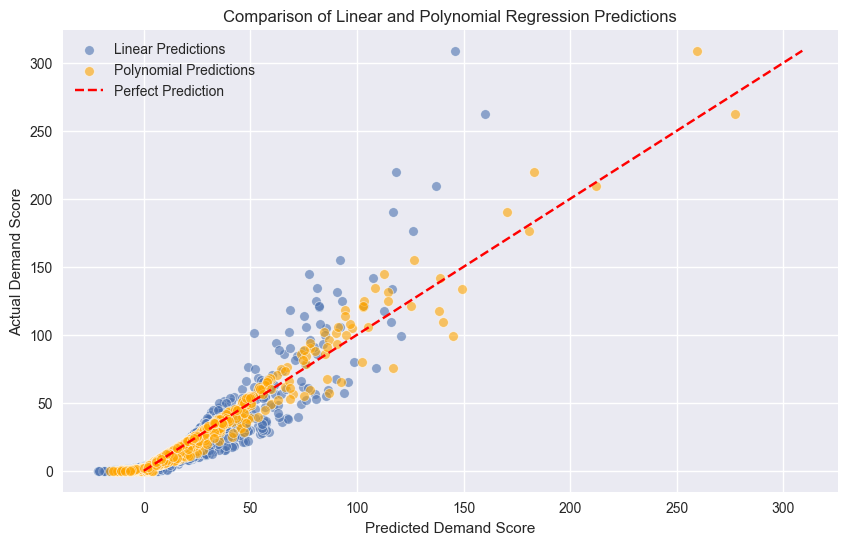

In [ ]:
# Polynomial regression

from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
import numpy as np

# Generate polynomial features
poly = PolynomialFeatures(degree=2, include_bias=False)  
X_poly = poly.fit_transform(X_scaled)

# Fit polynomial regression model
poly_model = LinearRegression()
poly_model.fit(X_poly, y)

# Make predictions
poly_predictions = poly_model.predict(X_poly)

# Evaluate performance
poly_mse = mean_squared_error(y, poly_predictions)
poly_r2 = r2_score(y, poly_predictions)

print("\nPolynomial Regression Results:")
print(f"Mean Squared Error: {poly_mse:.4f}")
print(f"R-squared: {poly_r2:.4f}")

# Visualize Polynomial Regression Results
plt.figure(figsize=(10, 6))
sns.scatterplot(x=predictions, y=y, label='Linear Predictions', alpha=0.6)
sns.scatterplot(x=poly_predictions, y=y, label='Polynomial Predictions', alpha=0.6, color='orange')
plt.plot([y.min(), y.max()], [y.min(), y.max()], color='red', linestyle='--', label='Perfect Prediction')
plt.xlabel('Predicted Demand Score')
plt.ylabel('Actual Demand Score')
plt.title("Comparison of Linear and Polynomial Regression Predictions")
plt.legend()
plt.show()


In [ ]:
# Compare our linear vs polynomial

# Linear Regression Metrics
linear_mse = mean_squared_error(y, predictions)
linear_r2 = r2_score(y, predictions)

# Print Summary of All Models
print("\nComparison of Regression Models:")
print(f"{'Model':<20}{'MSE':<15}{'R-squared':<10}")
print(f"{'Linear Regression':<20}{linear_mse:<15.4f}{linear_r2:<10.4f}")
print(f"{'Polynomial Regression':<20}{poly_mse:<15.4f}{poly_r2:<10.4f}")


Comparison of Regression Models:
Model               MSE            R-squared 
Linear Regression   161.3985       0.7866    
Polynomial Regression31.7956        0.9580    


### Classification (WIP)

We use visual analysis when trying to find underserved areas. This could be used to numerical back up those visual analysis

c:\Users\dar14\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\Users\dar14\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1382: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


Cluster centroids (scaled): [[0.35678608]
 [0.01611068]
 [0.08540901]
 [0.73742546]
 [0.18360353]]


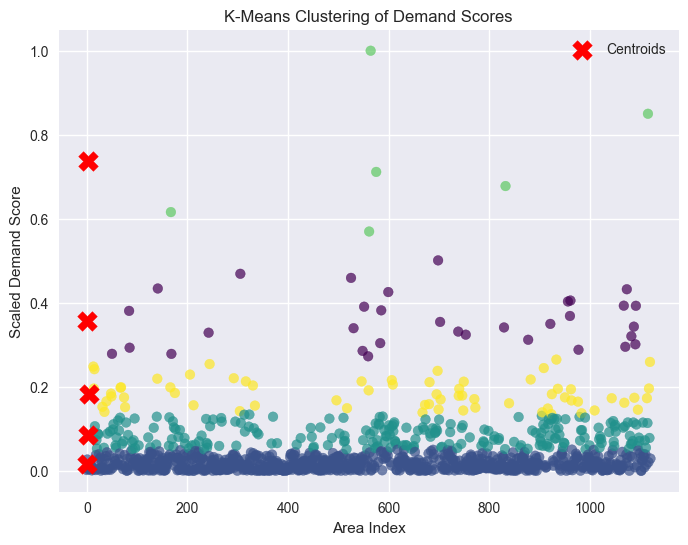

In [ ]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler

X = filtered_df[['demand_score']].values

scaler = MinMaxScaler()
X_scaled = scaler.fit_transform(X)

kmeans = KMeans(n_clusters=5, random_state=42)
filtered_df['cluster'] = kmeans.fit_predict(X_scaled)

centroids = kmeans.cluster_centers_
print("Cluster centroids (scaled):", centroids)

plt.figure(figsize=(8, 6))
plt.scatter(range(len(X_scaled)), X_scaled, c=filtered_df['cluster'], cmap='viridis', alpha=0.7)
plt.scatter(
    [i for i in range(len(centroids))],
    centroids,
    c='red',
    marker='X',
    s=200,
    label='Centroids'
)
plt.title("K-Means Clustering of Demand Scores")
plt.xlabel("Area Index")
plt.ylabel("Scaled Demand Score")
plt.legend()
plt.show()

high_demand_cluster = centroids.argmax()  # Cluster w/ the highest demand 
filtered_df['high_demand'] = filtered_df['cluster'].apply(lambda x: x == high_demand_cluster)

high_demand_areas = filtered_df[filtered_df['high_demand']]
# Could map these in the future by refrencing pre filtered df, copying previous folium map on focused df - Darwin


In [ ]:
# Define thresholds for visualizing demand scores
threshold_scale = [0, 12.5, 25, 50, 75, 150, 310]

# Identify the two clusters with the highest demand scores
top_two_clusters = centroids.argsort(axis=0)[-2:].flatten()

# Filter the data to only include blocks from the top two clusters
gdf_filtered = gdf[gdf['cluster'].isin(top_two_clusters)].copy()

# Reproject the data to WGS 84 (EPSG:4326) for mapping purposes
gdf_filtered = gdf_filtered.to_crs(epsg=4326)

# Convert the filtered data to GeoJSON format for mapping
geojson_data_filtered = gdf_filtered.to_json()

# Initialize
m_top_clusters = folium.Map(location=[42.3601, -71.0589], zoom_start=10)

# Overlay revelanct demand scores
folium.Choropleth(
    geo_data=geojson_data_filtered,
    name='choropleth',
    data=gdf_filtered,
    columns=['GEOID', 'demand_score'],
    key_on='feature.properties.GEOID',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    threshold_scale=threshold_scale,
    legend_name='Demand Score (Top Clusters)',
    reset=True
).add_to(m_top_clusters)

# Add tooltips
tooltip_fields = ['GEOID', 'demand_score', 'population_density', 'distance_to_stop']
tooltip_aliases = [
    "Block GEOID:",
    "Demand Score:",
    "Population Density:",
    "Distance to Stop (meters):"
]

folium.features.GeoJson(
    geojson_data_filtered,
    style_function=lambda x: {
        'fillColor': 'transparent',
        'color': 'transparent',
        'fillOpacity': 0.0,
        'weight': 0
    },
    tooltip=folium.features.GeoJsonTooltip(
        fields=tooltip_fields,
        aliases=tooltip_aliases,
        localize=True
    )
).add_to(m_top_clusters)

# Place markers
for _, row in mbta_stops_df.iterrows():
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=f"{row['stop_name']} ({row['municipality']}) - {row['route_id']} Line",
        icon=folium.Icon(color='blue', icon='train', prefix='fa')
    ).add_to(m_top_clusters)


m_top_clusters.add_child(Geocoder(add_marker=True))
folium.LayerControl().add_to(m_top_clusters)
m_top_clusters.save("demand_map_top_clusters.html")

In [ ]:
m_top_clusters